## Loading necessary libraries 

In [8]:
import tensorflow as tf
import pandas as pd
from tensorflow import keras

# Helper libraries
import numpy as np
import matplotlib.pyplot as plt
import Ttools.utils as utils
import Ttools.Keras_helpers_functions as kerash
import Ttools.NN_plot_helpers as plth
print(tf.__version__)

Using TensorFlow backend.


1.13.1


In [3]:
my_allen_folder="/allen/programs/celltypes/workgroups/rnaseqanalysis/Fahimehb/patchseq-work-dir/Patchseq_vs_FACs_cre_analysis/mouse_patchseq_VISp_20181220_collapsed40_cpm/"

In [3]:
#my_computer_folder = "/Users/fahimehb/Documents/Transcriptomic/DATA/"

## Importing the data

In [4]:
def read_data(path):
    file_path = path
    data = pd.read_csv(file_path)
    colnames = list(data['Unnamed: 0'])
    data = data.T
    data.columns =  colnames
    data = data.drop(axis=0, labels='Unnamed: 0')
    return data

In [5]:
V1_cl = pd.read_csv(my_allen_folder + "select_cl.csv")['x'].tolist()

In [7]:
def read_labels(path, select_cl):
    file_path = path
    labels = pd.read_csv(file_path)
    labels.index = list(labels['Unnamed: 0'])
    labels = labels.drop(axis=1, labels='Unnamed: 0')
    new_factors = np.arange(len(select_cl)).tolist()
    cls = select_cl
    refactor_cls = []
    for items in labels.cl:
        if items in cls: 
            index = cls.index(items)
            refactor_cls = refactor_cls + [new_factors[index]]
        else:
            refactor_cls = refactor_cls + [np.nan]
    labels["old_factor_cl"] = labels["factor_cl"]
    labels["factor_cl"] = refactor_cls 
    return labels

## Read the cell lists

In [8]:
FACs_data = read_data(my_allen_folder + "FACs_norm.csv")
FACs_labels = read_labels(my_allen_folder + "FACs_correct_labels.csv", V1_cl)
FACs_cells = FACs_data.index.tolist() 

In [11]:
train_cells = read_cell_list(my_computer_folder + "FACs_train_cells.txt")
test_cells = read_cell_list(my_computer_folder + "FACs_test_cells.txt")
validation_cells = read_cell_list(my_computer_folder + "FACs_validation_cells.txt")

In [12]:
FACs_data.shape

(13464, 4020)

## Build the model

In [9]:
def split_data(data, validation_size, testing_size):
    data = data.sample(frac=1)
    test_data = data.iloc[0:testing_size]
    validation_data = data.iloc[testing_size: (testing_size + validation_size)]
    train_data = data.iloc[(testing_size + validation_size):]
    return train_data, validation_data, test_data

In [10]:
def split_data_intwo(data, testing_size):
    data = data.sample(frac=1)
    test_data = data.iloc[0:testing_size]
    train_data = data.iloc[testing_size:]
    return train_data, test_data

In [11]:
def build_model_regular(n_features, n_cluster, HL_size, dropout_rate, 
                        learning_rate, HL_multiply, regularization=0.01):
    model = tf.keras.Sequential([
            #tf.keras.layers.Flatten(input_shape=(n_features,)),
            #tf.keras.layers.Dropout(dropout_rate, input_shape=(n_features,), noise_shape=None, seed=None),
            tf.keras.layers.Dense(HL_size * HL_multiply, input_shape=(n_features,)), 
                               #kernel_regularizer= regularizers.l2(regularization), 
                               #bias_regularizer=regularizers.l2(regularization)),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.Activation('relu'),
            #tf.keras.layers.Dense(HL_size * HL_multiply), 
            #tf.keras.layers.Activation('relu'),
            tf.keras.layers.Dense(n_cluster, activation=tf.nn.softmax)
    ])
    optim = tf.keras.optimizers.Adam(lr= learning_rate, decay=0.001)
    model.compile(optimizer=optim, loss='sparse_categorical_crossentropy', metrics=['accuracy'])

    return model


In [12]:
def build_model_CL(n_features , n_cluster , HL_size , dropout_rate ,allow_dropouts = False):
    model = keras.Sequential([
    keras.layers.Flatten(input_shape=(n_features,)),
    keras.layers.Dense(HL_size, activation=tf.nn.relu),
    keras.layers.Dense(HL_size, activation=tf.nn.relu),
    #keras.layers.Dense(HL_size, activation=tf.nn.relu),
    #keras.layers.Dropout(0.25, noise_shape=None, seed=None),
    keras.layers.Dense(n_cluster, activation=tf.nn.softmax)
    ])
    if allow_dropouts:
        model = keras.Sequential([
            keras.layers.Flatten(input_shape=(n_features,)),
            keras.layers.Dropout(dropout_rate, noise_shape=None, seed=None),
            keras.layers.Dense(HL_size, activation=tf.nn.relu),
            keras.layers.Dense(HL_size, activation=tf.nn.relu),
            keras.layers.Dense(HL_size, activation=tf.nn.relu),
            #keras.layers.Dense(70, activation=tf.nn.relu),
            keras.layers.Dense(n_cluster, activation=tf.nn.softmax)
        ])

    model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
    return model

In [13]:
def run_keras(model, train_data, train_labels, validation_data, validation_labels, epochs, batch_size):
 
    results = model.fit(train_data, train_labels, epochs=epochs, batch_size=batch_size, 
                        validation_data=(validation_data, validation_labels))

    return results 

In [14]:
def run_keras2(model, train_data, train_labels, epochs, batch_size):
 
    results = model.fit(train_data, train_labels, epochs=epochs, batch_size=batch_size)

    return results 

In [15]:
def plot_acc(results_history):
    plt.plot(results_history['acc'], label="Training_acc")
    plt.plot(results_history['val_acc'], label="Validation_acc")
    plt.xlabel("Epochs")
    plt.ylabel("Accuracy")
    plt.legend(loc="lower right")
    plt.show()

In [16]:
def plot_loss(results_history):
    plt.plot(results_history['loss'], label="Training_loss")
    plt.plot(results_history['val_loss'], label="Validation_loss")
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    plt.legend(loc="upper right")
    plt.show()

In [17]:
def predict(model, test_data, labels):
    test_cells = test_data.index.tolist()
    test_labels = labels.loc[test_cells]

    prediction = model.predict(test_data)
    predicted_cl = []
    scores = []
    for cell in range(test_labels.shape[0]):
        m = max(prediction[cell])
        scores = scores + [m]
        predicted_cl = predicted_cl + [i for i, j in enumerate(prediction[cell]) if j == m]
    test_labels['predicted_cl'] = predicted_cl
    return sum(test_labels['predicted_cl'] == test_labels['factor_cl']) * 1.0 / len(test_labels)

## Preparing data

In [49]:
train_data,  validation_data, test_data = split_data(FACs_data, 2232, 2232)


In [19]:
train_data = FACs_data.loc[train_cells]
test_data = FACs_data.loc[test_cells]
validation_data = FACs_data.loc[validation_cells]
train_labels = FACs_labels.loc[train_cells, 'factor_cl']
test_labels = FACs_labels.loc[test_cells, 'factor_cl']
validation_labels = FACs_labels.loc[validation_cells, 'factor_cl']

In [337]:
print train_data.shape
print validation_data.shape
print test_data.shape

(9000, 4020)
(2232, 4020)
(2232, 4020)


## Building the models:

Models built:

model_08_50_50 # 200 ephocs, accuracy on training is 76% validation 88% on test 87%

model_07_50_50  # 200 ephocs, accuracy on training is 85% validation 90% on test 89%

model_05_50_50  # 200 ephocs, accuracy on training is 97% validation 91% on test 90%

model_03_50_50  # 200 ephocs, overfit the training, validation 90% on test 90%

model_08_50_50_50 # 200 ephocs, accuracy on training is 83% validation 91% on test 89%

model_07_50_50_50 # 200 ephocs, accuracy on validation 91% on test 90%

model_05_50_50_50 # 200 ephocs, accuracy on validation 89% on test 89%

model_03_50_50_50 # 200 ephocs, overfit the training, accuracy on validation 90% on test 88%

model_07_80_80_80 # 200 ephocs, accuracy on training is 95% validation 92% on test 92%

model_08_80_80_80 # 200 ephocs, accuracy on training is % validation % on test %

model_07_90_90_90 # 200 ephocs, accuracy on training is 91% validation 91% on test 90%

model_07_50_50_50_50 # 200 ephocs, accuracy on training is 93% validation 91% on test 89%

model_07_60_60_60_60 # 200 ephocs, accuracy on training is 92% validation 92% on test 91%

model_07_70_70_70_70 # 200 ephocs, accuracy on training is 95% validation 92% on test 90%

In [21]:
model = build_model(n_features =4020 , n_cluster= 93 , HL_size=80 , dropout_rate=0.7 ,allow_dropouts = True)
results = run_keras(model, train_data = train_data, train_labels= train_labels, 
                    validation_data = validation_data , validation_labels= validation_labels, 
                    epochs =200, batch_size = 500)

model_07_80_80_80 = model
results_07_80_80_80 = results

Train on 9000 samples, validate on 2232 samples
Epoch 1/200
9000/9000 [==============================] - 3s 280us/step - loss: 4.5816 - acc: 0.1091 - val_loss: 3.4162 - val_acc: 0.2616

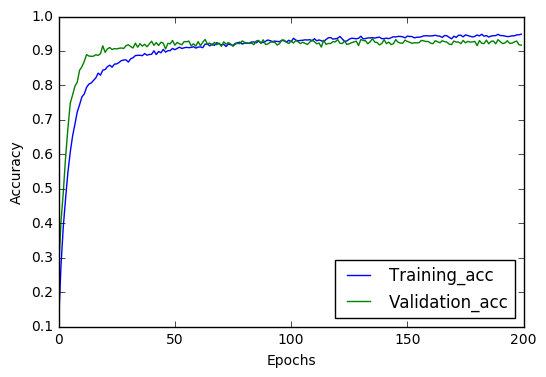

In [22]:
plot_acc(results.history)

## Prediction accuracy on TEST data (FACs)

In [102]:
predict(model_03_50_50, test_data, FACs_data, FACs_labels)

0.9032258064516129

In [97]:
predict(model_05_50_50, test_data, FACs_data, FACs_labels)

0.9032258064516129

In [90]:
predict(model_07_50_50, test_data, FACs_data, FACs_labels)

0.892921146953405

In [85]:
predict(model_08_50_50, test_data, FACs_data, FACs_labels)

0.8790322580645161

In [74]:
predict(model_03_50_50_50, test_data, FACs_data, FACs_labels)

0.882168458781362

In [68]:
predict(model_05_50_50_50, test_data, FACs_data, FACs_labels)

0.8911290322580645

In [66]:
predict(model_07_50_50_50, test_data, FACs_data, FACs_labels)

0.907258064516129

In [79]:
predict(model_08_50_50_50, test_data, FACs_data, FACs_labels)

0.8906810035842294

In [110]:
predict(model_05_50_50_50_50, test_data, FACs_data, FACs_labels)

0.9081541218637993

In [114]:
predict(model_07_50_50_50_50, test_data, FACs_data, FACs_labels)

0.8991935483870968

In [119]:
predict(model_07_60_60_60_60, test_data, FACs_data, FACs_labels)

0.9117383512544803

In [123]:
predict(model_07_70_70_70_70, test_data, FACs_data, FACs_labels)

0.9094982078853047

In [127]:
predict(model_07_70_70_70, test_data, FACs_data, FACs_labels)

0.9130824372759857

In [23]:
predict(model_07_80_80_80, test_data, FACs_labels)

0.9032258064516129

In [141]:
predict(model_08_80_80_80, test_data, FACs_data, FACs_labels)

0.9162186379928315

In [136]:
predict(model_07_90_90_90, test_data, FACs_data, FACs_labels)

0.9068100358422939

## Check if another set of genes can still be used for classification

For this, I am going to use 4020 genes from the whole 35000 genes, but they dont include any of these 4020 genes. I am going to use the same set of the cells as a bove.

In [382]:
path= my_allen_folder + "rg.norm.dat.csv"
RG_FACs_data = read_data(path)

In [383]:
RG_FACs_data

,Gm35632,Gm15320,Gm33152,Gm2754,2200002D01Rik,Gm36017,LOC105246338,Gm35600,Gm15071,Abt1,...,Snph,Bag2,Rdh1,1700036G14Rik,Gm21569,Apoc1,Gm35875,Gm5576,Gm4518,Gm32826
LS-14690_S02_E1-50,0,0,0,0,0,0,0,0,0,5.05563,...,4.17329,6.18626,0,0,0,0,0,0,1.49872,0
LS-14690_S03_E1-50,0,0,0,0,0,0,0,0,0,0,...,7.04515,0,0,0,0,0,0,0,0.637265,0
LS-14690_S05_E1-50,0,0,0,0,0,0,0,0,0,5.80765,...,6.21998,0,0,0,0,0,0,0,1.10979,0
LS-14690_S06_E1-50,0,0,0,0,0,0,0,0,0,0,...,6.54997,5.99945,0,0,0,0,0,0,0.588616,0
LS-14690_S07_E1-50,0,0,0,0,0,0,0,0,0,5.76504,...,5.63019,0,0,0,0,0,0,0.684016,0,0
LS-14690_S08_E1-50,0,0,0,0,0,0,0,0,0,4.2655,...,6.58034,2.17917,0,0,0,0,0,0,0,0
LS-14690_S09_E1-50,0,0,0,0,0,0,0,0,0,0,...,1.92889,0,0,0,0,0,0,0,0,0
LS-14690_S10_E1-50,0,0,0,0,0,0,0,0,0,6.07006,...,4.61382,0,0,0,0,0,0,0,0.775397,0
LS-14690_S11_E1-50,0,0,0,0,0,0,0,0,0,3.29791,...,6.87439,5.8926,0,0,0,0,0,0,0,0
LS-14690_S12_E1-50,0,0,0,0,0,0,0,0,0,6.46737,...,4.89542,6.10248,0,0,0,0,0,0,1.7642,0


In [384]:
rg_train_data = RG_FACs_data.loc[train_cells]
rg_test_data = RG_FACs_data.loc[test_cells]
rg_validation_data = RG_FACs_data.loc[validation_cells]

## Build the model based on the RANDOM 4020 genes

In [385]:
model = build_model(allow_dropouts=True, dropout_rate=0.7, HL_size=80, n_cluster=93, n_features=4020)
results = run_keras(model, train_data = rg_train_data, train_labels= train_labels, 
                    validation_data = rg_validation_data , validation_labels= validation_labels, 
                    epochs =200, batch_size = 500)

rg_model_07_80_80_80 = model
rg_results_07_80_80_80 = results

Train on 9000 samples, validate on 2232 samples
Epoch 1/200
9000/9000 [==============================] - 3s 344us/step - loss: 4.4833 - acc: 0.0796 - val_loss: 4.0160 - val_acc: 0.1263

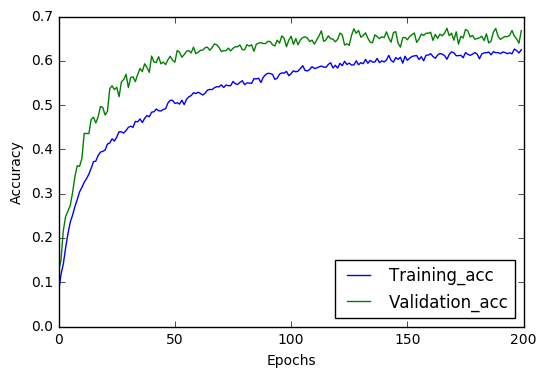

In [386]:
plot_acc(results.history)

In [391]:
model = build_model(allow_dropouts=True, dropout_rate=0.3, HL_size=80, n_cluster=93, n_features=4020)
results = run_keras(model, train_data = rg_train_data, train_labels= train_labels, 
                    validation_data = rg_validation_data , validation_labels= validation_labels, 
                    epochs =200, batch_size = 500)

rg_model_03_80_80_80 = model
rg_results_03_80_80_80 = results

Train on 9000 samples, validate on 2232 samples
Epoch 1/200
9000/9000 [==============================] - 3s 379us/step - loss: 4.2310 - acc: 0.0976 - val_loss: 3.8565 - val_acc: 0.1640

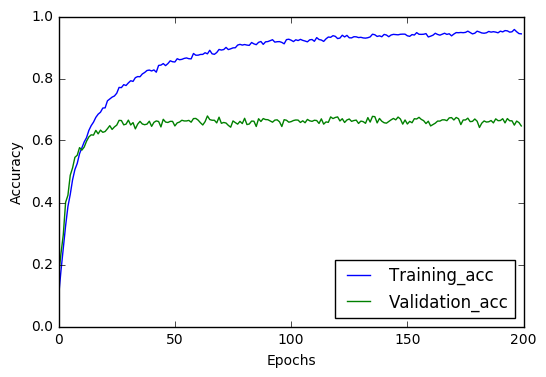

In [392]:
plot_acc(results.history)

In [388]:
predict(rg_model_07_80_80_80, rg_test_data, FACs_labels)

0.6590501792114696

In [393]:
predict(rg_model_03_80_80_80, rg_test_data, FACs_labels)

0.6482974910394266

## Build a model which has the Cre and Layer info as well

In [17]:
path= my_allen_folder + "Cre_layer_markers_norm.csv"
Cre_layer_FACs_data = read_data(path)

In [18]:
Cre_layer_FACs_data

,Scrg1,Nxph1,Krt73,Tmem45a,Piezo2,Pax6,Frmd7,Luzp2,Frem1,Sln,...,Ppcdc,Gtf2h2,Gfm2,Dennd4a,Skil,Tjp1,Nckap1,R3hdm1,layer_factor,genotype_factor
LS-14690_S02_E1-50,0,10.1507,0,0,0,0,0,9.36534,0,0,...,0,6.03378,3.65125,0,0,6.575,7.36391,7.57204,5,49
LS-14690_S03_E1-50,0,0,0,0,0.637265,0,0,0,0,0,...,5.05363,7.52136,6.83664,8.41317,7.29518,7.11039,8.60646,11.506,5,49
LS-14690_S05_E1-50,0,0,0,0,0,0,0,0,0,0,...,6.37899,2.63497,6.61888,6.77196,5.63348,5.06298,8.84794,10.1796,5,49
LS-14690_S06_E1-50,0,0,0,0,0,0,0,0,0,0,...,0,6.20061,6.69733,8.08235,5.97654,8.16318,8.62561,11.6714,5,49
LS-14690_S07_E1-50,0,0.684016,0,0,0,0,0,0,0,0,...,0,3.90226,7.24258,5.64775,6.37316,7.71199,9.23252,10.8556,5,49
LS-14690_S08_E1-50,0,0.667351,0,0,0,0,0,0,0,0,...,4.86945,3.86072,5.99848,6.41119,5.78425,4.92637,7.15134,10.9061,5,49
LS-14690_S09_E1-50,0,0,0,0,0.767151,0,0,0.767151,0,0,...,0,0,0.767151,8.15619,7.73454,8.45924,6.7413,11.4364,5,49
LS-14690_S10_E1-50,0,4.48219,0,0,1.64846,0,0,1.64846,0,0,...,0,0.775397,3.02088,7.2735,7.05156,0,6.2828,9.15385,5,49
LS-14690_S11_E1-50,0,0,0,0,0,0.576115,0,0.576115,0,0,...,0,2.43762,3.78257,6.24976,4.22264,6.91015,8.79672,10.9144,5,49
LS-14690_S12_E1-50,0,0,0,0,0,0,0,0,0,0,...,0,5.99815,3.6987,7.34154,0,4.95237,9.10925,10.6141,5,49


In [19]:
CL_train_data = Cre_layer_FACs_data.loc[train_cells]
CL_test_data = Cre_layer_FACs_data.loc[test_cells]
CL_validation_data = Cre_layer_FACs_data.loc[validation_cells]

In [34]:
model = build_model_CL(n_features=4022 , n_cluster =93 , HL_size=80 , dropout_rate=0.8 ,allow_dropouts = True)
results = run_keras(model, train_data = CL_train_data, train_labels= train_labels, 
                    validation_data = CL_validation_data , validation_labels= validation_labels, 
                    epochs =200, batch_size = 500)

CL_model_08_80_80_80 = model
CL_results_08_80_80_80 = results

Train on 9000 samples, validate on 2232 samples
Epoch 1/200
9000/9000 [==============================] - 3s 299us/step - loss: 4.9816 - acc: 0.0762 - val_loss: 3.7481 - val_acc: 0.1891

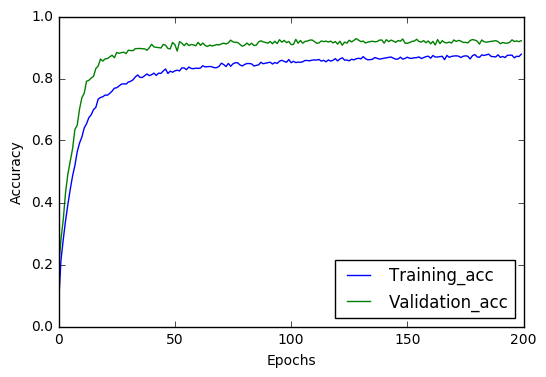

In [35]:
plot_acc(results.history)

In [32]:
predict(CL_model_07_80_80_80, CL_test_data, FACs_labels)

0.9036738351254481

In [36]:
predict(CL_model_08_80_80_80, CL_test_data, FACs_labels)

0.9077060931899642

I would conclude that adding the Cre and layer is not changing the accuracy that much.

In [37]:
CL_train_data.shape

(9000, 4022)

## Now lets use the best NN model we have to predict the cell types of Patchseq

These are the data before aligning. 

In [72]:
path = my_allen_folder + "patchseq_norm.csv"
Patchseq_data = read_data(path)

In [73]:
path = my_allen_folder + "patchseq_correct_labels.csv"
Patchseq_labels = read_labels(path, V1_cl)

In [74]:
Patchseq_data

,Scrg1,Nxph1,Krt73,Tmem45a,Piezo2,Pax6,Frmd7,Luzp2,Frem1,Sln,...,Gal3st4,Soga1,Ppcdc,Gtf2h2,Gfm2,Dennd4a,Skil,Tjp1,Nckap1,R3hdm1
P1S4_170410_003_A01,8.78447,0,0,0,1.10954,0,0,10.8739,0,0,...,0,0,0,0,5.06252,0,4.59426,6.65202,7.8757,0
P1S4_170410_004_A01,0,1.37915,0,0,0,0,0,1.37915,0,0,...,0,0,0,0,8.82695,2.07118,0,3.94583,10.0919,10.5779
P1S4_170411_004_A01,0,0,0,0,0,0,0,0,0,0,...,0,0,0,7.43981,5.44961,0,7.10099,5.15075,9.09549,12.1273
P1S4_170411_007_A01,6.27717,0,0,0,0.951298,0,0,0.951298,0,0,...,0,0,0,0,0,8.78376,6.53129,9.19338,5.57533,11.5394
P1S4_170411_008_A01,4.84932,0,0,0,0,0,0,1.373,0,0,...,0,0,0,0,1.373,8.38766,8.91764,6.82147,8.22851,10.4292
P1S4_170412_004_A01,6.09325,0,0,0,0,0,0,0,0,0,...,0,0,0,0,5.58959,8.72622,7.71243,4.48392,9.00043,10.5888
P1S4_170413_004_A01,5.20664,1.19102,0,0,0,0,0,8.16238,0.715076,0,...,0,0,6.42101,2.07308,7.4448,9.37726,0.715076,8.88629,8.74027,11.3651
P1S4_170413_005_A01,0,0,0,1.45954,1.85811,0,0,3.00015,0,0,...,0,0,0,0,0.906972,4.85815,5.89802,8.28384,5.33556,12.0582
P2S4_170413_053_A01,0,0.876635,0,0,1.41802,0,0,0,3.22664,0,...,0,0,6.94332,0,6.12017,6.17128,0,9.30815,6.91361,11.1925
P2S4_170413_057_A01,0,0,0,0,0,0,0,4.4569,0,0,...,0,0,0,0,0,8.74219,0,8.74554,8.80792,11.3006


In [40]:
V1_markers = Patchseq_data.columns.tolist()

In [41]:
Patchseq_cells = Patchseq_data.index.tolist()

In [42]:
NN_Patchseq_memb_df = compute_membership(model_07_80_80_80, Patchseq_cells, V1_cl, Patchseq_data, V1_markers)

In [43]:
NN_Patchseq_results = NN_results(memb=NN_Patchseq_memb_df, select_cl= V1_cl)

In [44]:
good_cells = Patchseq_labels[pd.notnull(Patchseq_labels["factor_cl"])].index.tolist()
#good_cells = Patchseq_cells
combined = NN_Patchseq_results.loc[good_cells].join(Patchseq_labels.loc[good_cells])
print "Accuracy compared two clustering"
sum(combined["cl"] == combined["NN_cl"]) * 1.0 / combined.shape[0]

Accuracy compared two clustering


0.7404458598726115

In [45]:
NN_Patchseq_memb_df

,L2/3 IT VISp Rrad,L2/3 IT VISp Adamts2,L2/3 IT VISp Agmat,L4 IT VISp Rspo1,L5 IT VISp Hsd11b1 Endou,L5 IT VISp Whrn Tox2,L5 IT VISp Batf3,L5 IT VISp Col6a1 Fezf2,L5 IT VISp Col27a1,L6 IT VISp Penk Col27a1,...,Pvalb Th Sst,Pvalb Calb1 Sst,Pvalb Akr1c18 Ntf3,Pvalb Sema3e Kank4,Pvalb Gpr149 Islr,Pvalb Reln Itm2a,Pvalb Reln Tac1,Pvalb Tpbg,Pvalb Vipr2,Meis2 Adamts19
P1S4_170410_003_A01,3.554980e-09,2.814437e-09,9.104719e-08,1.030426e-05,1.114326e-05,4.642229e-06,3.712546e-05,1.532533e-07,1.235177e-06,2.015762e-05,...,5.515371e-04,2.471713e-03,4.176798e-04,1.259227e-04,6.057716e-03,6.366842e-05,2.829770e-04,2.122616e-02,8.125412e-01,2.140355e-02
P1S4_170410_004_A01,7.583644e-06,6.824245e-07,1.405300e-06,8.801091e-08,3.608829e-07,5.473599e-08,8.811556e-08,9.229007e-08,3.444971e-05,5.341328e-04,...,2.305545e-06,6.235636e-08,1.510790e-08,4.873538e-09,3.908181e-06,1.723915e-05,2.852478e-05,2.485781e-06,3.628583e-07,7.776612e-05
P1S4_170411_004_A01,2.186014e-07,6.204749e-10,3.872990e-09,1.605438e-07,6.705585e-07,3.094593e-08,2.073194e-08,3.915517e-07,5.218581e-05,7.731855e-04,...,8.974335e-08,4.347749e-12,1.166393e-11,9.629422e-14,8.683462e-10,8.966661e-10,9.696003e-08,3.516710e-10,2.549712e-08,2.039295e-06
P1S4_170411_007_A01,2.817576e-05,4.022373e-07,5.865805e-07,5.995607e-08,3.519418e-07,1.313866e-07,4.881424e-06,1.217049e-06,8.766225e-06,4.022706e-02,...,1.018185e-07,1.288444e-11,1.233537e-10,4.935616e-12,2.495919e-09,2.148969e-08,9.564211e-08,1.101677e-09,1.572797e-09,2.416193e-05
P1S4_170411_008_A01,5.868158e-06,2.778287e-07,1.820023e-04,1.097784e-07,2.056067e-05,4.459298e-06,2.423102e-05,1.304768e-06,2.211688e-03,4.366196e-04,...,9.078368e-06,1.752291e-05,5.121498e-07,2.074424e-08,7.644228e-04,2.193315e-05,1.177018e-04,1.382151e-03,6.687387e-04,2.262170e-03
P1S4_170412_004_A01,2.405584e-08,6.850019e-09,1.310033e-08,4.023289e-08,2.881871e-08,3.214865e-09,2.114588e-08,1.040859e-06,1.362822e-04,6.933863e-02,...,3.342858e-07,8.963132e-11,4.822096e-11,1.204654e-11,3.020213e-09,4.779850e-09,6.425210e-09,7.456599e-10,2.530658e-10,3.050508e-06
P1S4_170413_004_A01,5.828763e-05,1.765165e-06,6.150306e-08,1.330493e-12,2.859305e-09,1.006466e-08,1.487982e-09,1.458855e-11,6.140177e-12,2.504513e-09,...,1.814796e-10,8.832129e-16,1.844452e-13,1.882779e-13,5.010485e-11,1.033316e-11,4.195928e-08,4.578943e-10,3.767861e-12,7.023180e-06
P1S4_170413_005_A01,1.406227e-05,1.503696e-06,2.957947e-06,7.822086e-06,1.379382e-05,1.147338e-07,2.396614e-07,2.487750e-06,2.606787e-03,4.467053e-01,...,3.865940e-06,1.104617e-09,1.876045e-09,4.489008e-11,6.495934e-08,6.091379e-07,1.306849e-06,2.721116e-08,7.431430e-09,6.418526e-03
P2S4_170413_053_A01,2.063489e-11,1.393068e-09,6.111627e-07,8.536867e-01,1.463079e-01,1.315179e-06,3.641958e-07,1.005867e-08,2.494432e-08,2.802450e-10,...,3.271141e-12,2.840475e-18,3.656537e-16,2.948005e-21,2.670358e-15,3.925763e-14,1.012013e-13,2.112838e-15,2.749400e-13,2.777260e-06
P2S4_170413_057_A01,5.159295e-10,8.586365e-08,8.850904e-06,9.986150e-01,1.360107e-03,2.755970e-08,7.393176e-08,7.825923e-09,1.325575e-05,1.537710e-09,...,2.467451e-11,8.356115e-20,3.116125e-18,2.417579e-20,4.405979e-15,5.928420e-14,8.675101e-14,3.003035e-15,1.954858e-15,7.841575e-07


In [46]:
path = my_allen_folder + "NN_Patchseq_memb_df.csv"
NN_Patchseq_memb_df.to_csv(path)

path = my_allen_folder + "NN_Patchseq_results.csv"
combined.to_csv(path)

## Compute the memb matrix for FACs data for KLdiv analysis

In [47]:
NN_FACs_memb_df = compute_membership(model_07_80_80_80, FACs_cells, V1_cl, FACs_data, V1_markers)
NN_FACs_results = NN_results(memb=NN_FACs_memb_df, select_cl= V1_cl)

In [51]:
#good_cells = Patchseq_labels[pd.notnull(Patchseq_labels["factor_cl"])].index.tolist()
good_cells = FACs_cells
combined = NN_FACs_results.loc[good_cells].join(FACs_labels.loc[good_cells])
print "Accuracy compared two clustering"
sum(combined["cl"] == combined["NN_cl"]) * 1.0 / combined.shape[0]

Accuracy compared two clustering


0.9689542483660131

In [53]:
path = my_allen_folder + "NN_FACs_memb_df.csv"
NN_FACs_memb_df.to_csv(path)

path = my_allen_folder + "NN_FACs_results.csv"
combined.to_csv(path)

## What if we align the Patchseq and FACs data and then map them

In [41]:
path = my_allen_folder + "aligned_patchseq.csv"
Patchseq_data = read_data(path)

In [42]:
path = my_allen_folder + "patchseq_correct_labels.csv"
Patchseq_labels = read_labels(path, select_cl)

In [43]:
Patchseq_data.shape

(7076, 4020)

In [44]:
Patchseq_labels.shape

(7076, 3)

In [59]:
good_cells = Patchseq_labels[pd.notnull(Patchseq_labels["factor_cl"])].index.tolist()
patchseq_cells = Patchseq_labels.index.tolist()
select_cells = good_cells
data = Patchseq_data.loc[select_cells]
data_labels =  Patchseq_labels.loc[select_cells]

prediction = model_07_80_80_80.predict(data)
predicted_cl = []
NN_support = []
for cell in range(len(select_cells)):
    m = max(prediction[cell])
    predicted_cl = predicted_cl + [i for i, j in enumerate(prediction[cell]) if j == m]
    NN_support = NN_support + [m]
data_labels['predicted_cl'] = predicted_cl
data_labels['NN_support'] = NN_support
print "Match between two methods for good cells:"
print sum(data_labels['predicted_cl'] == data_labels['factor_cl']) * 1.0 / len(select_cells)

Match between two methods for good cells:
0.7435241445474896


In [60]:
Patchseq_data

,Scrg1,Nxph1,Krt73,Tmem45a,Piezo2,Pax6,Frmd7,Luzp2,Frem1,Sln,...,Gal3st4,Soga1,Ppcdc,Gtf2h2,Gfm2,Dennd4a,Skil,Tjp1,Nckap1,R3hdm1
P1S4_170410_003_A01,4.10509,0.159639,-0.0212921,0.0109871,0.92917,-1.5164,0,3.90146,-0.301127,0,...,0.12573,-0.482909,-0.132742,2.27488,6.6831,2.41145,6.90356,8.2322,10.8662,4.76307
P1S4_170410_004_A01,-0.516967,0.648485,0,-0.0678796,-0.259189,-0.263974,-0.0690827,-0.593804,-0.0272249,0.147573,...,0.536391,-0.102299,0.70861,0.89654,10.8013,2.02037,2.22794,4.38061,12.1213,10.2436
P1S4_170411_004_A01,-1.22821,-0.310316,0,0.00516429,-0.343923,0.0702739,-0.0486477,-1.03148,-0.359925,0.10323,...,0.241151,-0.384746,-0.549831,10.1142,6.44262,-0.996684,8.78771,4.84518,10.298,10.9918
P1S4_170411_007_A01,5.17116,-0.299749,0,0.000517484,0.605543,-0.0498064,-0.0590655,-0.18661,-0.315723,0.0891504,...,0.400214,-0.226463,-0.52503,2.26389,0.634957,8.04383,7.67611,8.59289,6.7668,10.3657
P1S4_170411_008_A01,2.42916,-1.23383,-0.00598237,-0.0448878,-0.401923,-0.912157,0.00526369,-2.59029,-0.109893,0,...,-0.158324,-1.31201,-0.277074,1.46504,0.946352,8.33041,9.92962,5.9999,9.69691,10.3275
P1S4_170412_004_A01,4.78548,-0.365599,0,0.00625989,-0.347277,0.063612,-0.0428322,-1.42852,-0.307863,0.0974085,...,0.493129,-0.297626,-0.368485,2.48117,6.55321,8.28174,9.00519,3.84151,10.1749,9.50675
P1S4_170413_004_A01,4.44989,1.30185,0.167146,-0.0115995,-0.149694,0.317118,0,9.27988,0.595981,0,...,0.142327,-0.0778733,6.80793,2.65064,6.6248,7.76771,1.64325,8.0262,10.0536,10.468
P1S4_170413_005_A01,-0.652628,-0.365696,0,1.50991,1.57304,-0.22335,-0.0424627,1.72749,-0.233424,0.0721726,...,0.368686,-0.39919,-1.03351,2.01903,1.05278,3.36181,6.73528,7.54199,6.60121,10.9574
P2S4_170413_053_A01,-0.306998,0.651134,0,0.00508868,0.478034,0.212669,0,0.337922,2.47598,0.000898054,...,0.110193,0.120185,7.29698,1.44484,6.54238,5.42351,1.22925,8.6574,8.54175,10.5969
P2S4_170413_057_A01,-0.691346,-0.236763,0,0.0253733,-0.304356,-0.0606895,-0.00776235,3.85202,-0.123719,0,...,0.259576,-0.0372772,-0.08328,1.05656,2.12899,7.83692,1.17698,9.20263,10.1797,10.6304


## What if we train the model on aligned data and redo patchseq prediction

In [53]:
path = my_allen_folder + "aligned_FACs.csv"
a_facs_data = read_data(path)

In [55]:
a_facs_data.equals(FACs_data)

True

This means that FACs data frame did not change at all after alignment. 

# M1 data analysis

In [32]:
path = my_allen_folder +  "SmartSeq_cells.csv"
SmartSeq_cells = pd.read_csv(path)['x'].tolist()
path = my_allen_folder +  "TenX_cells.csv"
TenX_cells = pd.read_csv(path)['x'].tolist()
path = my_allen_folder + "comb_markers.csv"
comb_markers = pd.read_csv(path)['x'].tolist()

In [37]:
def read_data(path, cells, markers):
    import scipy.io
    data = scipy.io.mmread(path)
    data = data.todense()
    data = np.array(data)
    data = pd.DataFrame(data, columns=cells, index= markers )
    return data.T

In [38]:
path = my_allen_folder + "SmartSeq_cells_AIBS.norm.csv"
SmartSeq_data = read_data(path, SmartSeq_cells, comb_markers)

In [43]:
path = my_allen_folder + "TenX_cells_AIBS.norm.csv"
TenX_data = read_data(path, TenX_cells, comb_markers)

In [44]:
TenX_data

,10X_cells_AIBS.AAACCTGAGAATCTCC-6L8TX_171026_01_B05,10X_cells_AIBS.AAACCTGAGACGACGT-2L8TX_171026_01_G03,10X_cells_AIBS.AAACCTGAGACTAAGT-10L8TX_171026_01_A04,10X_cells_AIBS.AAACCTGAGAGGTTAT-15L8TX_171026_01_G05,10X_cells_AIBS.AAACCTGAGAGTCTGG-16L8TX_171026_01_H05,10X_cells_AIBS.AAACCTGAGATAGGAG-8L8TX_171026_01_A05,10X_cells_AIBS.AAACCTGAGATATGCA-7L8TX_171026_01_H04,10X_cells_AIBS.AAACCTGAGATGGGTC-16L8TX_171026_01_H05,10X_cells_AIBS.AAACCTGAGATTACCC-8L8TX_171026_01_A05,10X_cells_AIBS.AAACCTGAGCACCGTC-2L8TX_171026_01_G03,...,10X_cells_AIBS.TTTGTCATCACCTTAT-9L8TX_171026_01_H03,10X_cells_AIBS.TTTGTCATCACGATGT-2L8TX_171026_01_G03,10X_cells_AIBS.TTTGTCATCACGGTTA-3L8TX_171026_01_B04,10X_cells_AIBS.TTTGTCATCAGTGCAT-9L8TX_171026_01_H03,10X_cells_AIBS.TTTGTCATCCCTAACC-2L8TX_171026_01_G03,10X_cells_AIBS.TTTGTCATCCTATGTT-12L8TX_171026_01_D05,10X_cells_AIBS.TTTGTCATCGCTTGTC-3L8TX_171026_01_B04,10X_cells_AIBS.TTTGTCATCGGCGCAT-11L8TX_171026_01_C05,10X_cells_AIBS.TTTGTCATCTGAGTGT-8L8TX_171026_01_A05,10X_cells_AIBS.TTTGTCATCTGCGTAA-10L8TX_171026_01_A04
0610040J01Rik,0.000000,0.000000,0.000000,0.000000,0.000000,6.301174,0.000000,0.000000,4.758633,6.902363,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1110002O04Rik,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1110004F10Rik,7.287985,6.475813,6.510766,5.937622,6.884948,7.873888,8.118536,5.783696,6.718098,6.902363,...,8.128373,8.980232,7.504387,8.430606,6.986704,0.000000,6.415243,7.829401,9.091528,6.867661
1110008P14Rik,9.865234,10.161213,9.496855,10.307347,10.428325,10.283919,9.203248,9.566526,9.230295,7.896320,...,8.449269,7.983086,7.504387,8.430606,7.567869,7.426499,7.406766,0.000000,0.000000,0.000000
1110032F04Rik,0.000000,0.000000,6.510766,5.937622,6.884948,0.000000,5.154423,0.000000,0.000000,5.914373,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.867661
1190002N15Rik,7.869867,0.000000,0.000000,0.000000,5.897103,0.000000,5.154423,5.783696,0.000000,0.000000,...,6.143758,0.000000,0.000000,0.000000,7.567869,7.426499,0.000000,0.000000,0.000000,0.000000
1500009L16Rik,0.000000,0.000000,0.000000,0.000000,7.204432,0.000000,6.712125,0.000000,5.731736,0.000000,...,0.000000,0.000000,0.000000,0.000000,6.986704,0.000000,0.000000,0.000000,0.000000,0.000000
1500035N22Rik,0.000000,6.475813,0.000000,0.000000,0.000000,6.301174,5.154423,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1700001L19Rik,0.000000,0.000000,0.000000,5.937622,4.921111,0.000000,0.000000,0.000000,4.758633,5.914373,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1700001O22Rik,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.783696,0.000000,0.000000,...,0.000000,7.400971,0.000000,0.000000,6.986704,0.000000,0.000000,0.000000,6.299954,0.000000


In [49]:
path = my_allen_folder + "M1_select_cl.csv"
select_cl = pd.read_csv(path)['x'].tolist()

In [144]:
path = my_allen_folder + "SmartSeq_cells_AIBS_labels.csv"
SmartSeq_labels = read_labels(path, select_cl)

In [145]:
path = my_allen_folder + "TenX_cells_AIBS_labels.csv"
TenX_labels = read_labels(path, select_cl)

In [53]:
select_cl

['L2/3 IT Egr2',
 'L2/3 IT Ccdc3',
 'L2/3 IT Met',
 'L2/3 IT Adra1b',
 'L2/3 IT Rorb',
 'L5 IT Rspo1_1',
 'L5 IT Rspo1_2',
 'L5 IT Slc5a5',
 'L5 IT Prss23',
 'L5 IT Pld5',
 'L6 IT Fst',
 'L6 IT Penk',
 'L6 IT Car3',
 'L5 PT Slco2a1',
 'L5 PT Stk17b',
 'L5 PT Npsr1',
 'L5 NP Slc17a8',
 'L6 NP Trh_1',
 'L6 NP Trh_2',
 'L6 NP CT',
 'L6 CT Cpa6_1',
 'L6 CT Cpa6_2',
 'L6 CT Brinp3',
 'L6 CT Nxph2 Pou3f2',
 'L6 CT Nxph2 Kit',
 'L6b Rprm',
 'L6b Shisa6_1',
 'L6b Shisa6_2',
 'L6b Ror1',
 'L6b Kcnip1_1',
 'L6b Kcnip1_2',
 'Lamp5 Pax6_1',
 'Lamp5 Pax6_2',
 'Lamp5 Egln3_1',
 'Lamp5 Egln3_2',
 'Lamp5 Pdlim5',
 'Lamp5 Slc35d3_1',
 'Lamp5 Slc35d3_2',
 'Lamp5 Lhx6',
 'Sncg Col14a1_1',
 'Sncg Col14a1_2',
 'Sncg Slc17a8',
 'Sncg Calb1_1',
 'Sncg Calb1_2',
 'Sncg Npy2r_1',
 'Sncg Npy2r_2',
 'Vip Serpinf1_1',
 'Vip Serpinf1_2',
 'Vip Htr1f_1',
 'Vip Igfbp6_1',
 'Vip Igfbp6_2',
 'Vip Mybpc1',
 'Vip Chat',
 'Vip Lypd1',
 'Vip Cbln4',
 'Vip Gpc3',
 'Vip C1ql1',
 'Vip Crispld2',
 'Sst Chodl',
 'Sst Myh8_1',


In [52]:
SmartSeq_labels

,sample_id,factor_cl,cl,old_factor_cl
1,SmartSeq_cells_AIBS.LS-15395_S43_E1-50,17,L6 NP Trh_1,18
2,SmartSeq_cells_AIBS.LS-15395_S44_E1-50,16,L5 NP Slc17a8,17
3,SmartSeq_cells_AIBS.LS-15395_S46_E1-50,8,L5 IT Prss23,9
4,SmartSeq_cells_AIBS.LS-15395_S48_E1-50,8,L5 IT Prss23,9
5,SmartSeq_cells_AIBS.LS-15395_S50_E1-50,8,L5 IT Prss23,9
6,SmartSeq_cells_AIBS.LS-15395_S52_E1-50,16,L5 NP Slc17a8,17
7,SmartSeq_cells_AIBS.LS-15395_S54_E1-50,5,L5 IT Rspo1_1,6
8,SmartSeq_cells_AIBS.LS-15395_S56_E1-50,6,L5 IT Rspo1_2,7
9,SmartSeq_cells_AIBS.LS-15396_S41_E1-50,7,L5 IT Slc5a5,8
10,SmartSeq_cells_AIBS.LS-15396_S42_E1-50,7,L5 IT Slc5a5,8


In [57]:
TenX_labels

,sample_id,factor_cl,cl,old_factor_cl
1,10X_cells_AIBS.AAACCTGAGAATCTCC-6L8TX_171026_0...,5,L5 IT Rspo1_1,6
2,10X_cells_AIBS.AAACCTGAGACGACGT-2L8TX_171026_0...,5,L5 IT Rspo1_1,6
3,10X_cells_AIBS.AAACCTGAGACTAAGT-10L8TX_171026_...,6,L5 IT Rspo1_2,7
4,10X_cells_AIBS.AAACCTGAGAGGTTAT-15L8TX_171026_...,7,L5 IT Slc5a5,8
5,10X_cells_AIBS.AAACCTGAGAGTCTGG-16L8TX_171026_...,13,L5 PT Slco2a1,14
6,10X_cells_AIBS.AAACCTGAGATAGGAG-8L8TX_171026_0...,3,L2/3 IT Adra1b,4
7,10X_cells_AIBS.AAACCTGAGATATGCA-7L8TX_171026_0...,9,L5 IT Pld5,10
8,10X_cells_AIBS.AAACCTGAGATGGGTC-16L8TX_171026_...,1,L2/3 IT Ccdc3,2
9,10X_cells_AIBS.AAACCTGAGATTACCC-8L8TX_171026_0...,11,L6 IT Penk,12
10,10X_cells_AIBS.AAACCTGAGCACCGTC-2L8TX_171026_0...,11,L6 IT Penk,12


In [60]:
print SmartSeq_data.shape
print SmartSeq_labels.shape
print TenX_data.shape
print TenX_labels.shape

(3870, 6244)
(6244, 4)
(3870, 122891)
(122891, 4)


## First we build the model using Smartseq data

In [28]:
def compute_membership(model, select_cells, select_cl, data, markers):
    memb = pd.DataFrame(columns=select_cl, index=select_cells)
    data = data.loc[select_cells][markers]
    prediction = model.predict(data)
    memb = pd.DataFrame(prediction,columns=select_cl, index=select_cells )
    return memb

In [29]:
def NN_results(memb,select_cl):
    NN_results = pd.DataFrame()
    NN_cl = memb.idxmax(axis=1)
    NN_support =  memb.max(axis=1)
    NN_cl_factor = [select_cl.index(i) for i in NN_cl]
    NN_results['NN_cl'] = NN_cl
    NN_results['NN_support'] = NN_support
    NN_results['NN_cl_factor'] = NN_cl_factor
    return NN_results 

In [76]:
train_data,  validation_data, test_data = split_data(SmartSeq_data, 872, 872)

In [77]:
train_data

,0610040J01Rik,1110002O04Rik,1110004F10Rik,1110008P14Rik,1110032F04Rik,1190002N15Rik,1500009L16Rik,1500035N22Rik,1700001L19Rik,1700001O22Rik,...,Zfyve28,Zhx2,Zhx3,Zim1,Zmat4,Zmiz1,Zmym1,Zmynd8,Zswim6,Zyx
SmartSeq_cells_AIBS.SM-DAIGV_S11_E1-50,0.000000,2.778840,8.256804,7.367757,0.000000,0.000000,5.582075,0.000000,0.000000,0.000000,...,4.921961,6.735171,0.000000,0.000000,3.669708,5.582075,7.085861,6.566938,6.474843,0.000000
SmartSeq_cells_AIBS.SM-DAIGR_S54_E1-50,0.498289,0.000000,7.795194,7.462120,6.785581,0.000000,0.000000,0.000000,6.730598,0.000000,...,0.000000,3.002366,5.172553,0.000000,7.086397,0.000000,6.152412,5.428905,3.869252,5.237097
SmartSeq_cells_AIBS.SM-D9D7W_S84_E1-50,0.000000,3.386762,8.892796,9.992354,0.926697,3.616061,4.528102,0.000000,6.715016,0.000000,...,0.000000,0.536510,0.000000,0.000000,0.000000,2.679313,5.759001,6.895064,5.539046,3.323252
SmartSeq_cells_AIBS.SM-DAIGW_S16_E1-50,0.000000,0.000000,7.275851,9.094453,0.000000,0.000000,0.000000,0.000000,7.096231,0.000000,...,6.077222,1.516354,4.071738,0.000000,5.556173,5.421732,6.839216,4.627815,5.324599,7.036141
SmartSeq_cells_AIBS.SM-D9D7V_S04_E1-50,0.000000,0.000000,9.186577,8.916518,0.000000,0.000000,4.841369,0.000000,7.094922,0.000000,...,7.208516,0.730107,5.453502,0.000000,0.000000,3.257600,5.849337,6.298913,4.420996,5.897962
SmartSeq_cells_AIBS.SM-GE92H_S116_E1-50,0.000000,0.000000,8.939814,6.140773,0.000000,0.000000,0.000000,0.000000,5.855803,5.161076,...,0.000000,0.000000,0.000000,0.000000,5.161076,7.313702,0.000000,7.225013,4.319823,6.074632
SmartSeq_cells_AIBS.SM-GE92L_S186_E1-50,0.000000,0.000000,8.227126,6.204905,0.000000,2.820470,0.000000,0.000000,0.000000,0.000000,...,4.968995,0.000000,0.000000,0.000000,8.366181,4.742635,0.000000,6.015051,3.872221,6.346017
SmartSeq_cells_AIBS.SM-D9D85_S54_E1-50,0.000000,0.000000,7.598628,9.076767,6.446589,4.794830,0.000000,0.000000,6.535145,0.000000,...,5.928059,3.428783,0.000000,0.000000,6.134035,6.259308,4.099272,4.901186,0.510688,6.921228
SmartSeq_cells_AIBS.SM-DD44B_S62_E1-50,0.000000,0.000000,9.102041,8.612211,0.000000,6.227177,7.131182,0.000000,6.414283,0.000000,...,0.000000,0.000000,3.663429,0.000000,8.558640,0.518283,6.981310,6.863080,0.000000,0.000000
SmartSeq_cells_AIBS.SM-GE92I_S280_E1-50,0.000000,0.000000,8.540997,6.824527,0.000000,5.521566,0.000000,0.000000,0.000000,5.612712,...,1.320704,0.000000,0.000000,0.000000,2.805607,0.000000,0.000000,5.373049,3.521699,6.301767


In [152]:
SmartSeq_labels = SmartSeq_labels.set_index('sample_id')
TenX_labels = TenX_labels.set_index('sample_id')

In [157]:
print SmartSeq_labels.shape
print TenX_labels.shape

(6244, 3)
(122891, 3)


In [158]:
train_cells = train_data.index.tolist()
test_cells = test_data.index.tolist()
validation_cells = validation_data.index.tolist()

train_labels = SmartSeq_labels.loc[train_cells, 'factor_cl']
test_labels = SmartSeq_labels.loc[test_cells, 'factor_cl']
validation_labels = SmartSeq_labels.loc[validation_cells, 'factor_cl']

In [159]:
print train_data.shape
print test_data.shape
print validation_data.shape

(4500, 3870)
(872, 3870)
(872, 3870)


In [87]:
write_out_list(my_allen_folder + "Smartseq_train_cells.csv", train_cells)
write_out_list(my_allen_folder + "Smartseq_test_cells.csv", test_cells)
write_out_list(my_allen_folder + "Smartseq_validation_cells.csv", validation_cells)

In [99]:
len(select_cl)

81

In [313]:
model = build_model(allow_dropouts=True, n_features=3870, n_cluster= 81, HL_size= 50, dropout_rate=  0.5)
results = run_keras(model, train_data = train_data, train_labels= train_labels, 
                    validation_data = validation_data , validation_labels= validation_labels, 
                    epochs =200, batch_size = 500)

M1_model_05_50_50_50 = model
M1_results_05_50_50_50 = results

Train on 4500 samples, validate on 872 samples
Epoch 1/200
4500/4500 [==============================] - 1s 321us/step - loss: 4.7296 - acc: 0.0422 - val_loss: 3.9515 - val_acc: 0.1823
Epoch 2/200
4500/4500 [==============================] - 1s 160us/step - loss: 3.6841 - acc: 0.2051 - val_loss: 3.2477 - val_acc: 0.2397

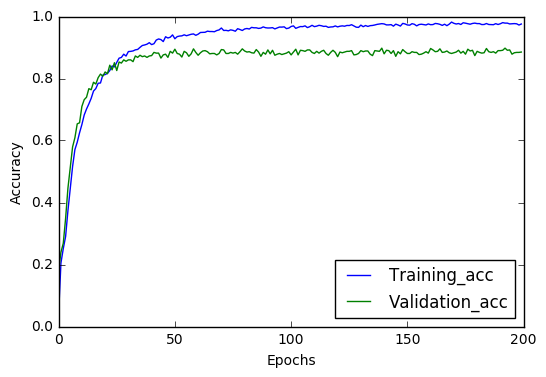

In [314]:
plot_acc(results.history)

## Predicting Smartseq test data

In [118]:
predict(M1_model_07_80_80_80, test_data, SmartSeq_labels)

0.8887614678899083

In [111]:
predict(M1_model_07_70_70_70, test_data, SmartSeq_labels)

0.8922018348623854

In [116]:
predict(M1_model_07_60_60_60, test_data, SmartSeq_labels)

0.8841743119266054

In [310]:
predict(M1_model_07_50_50_50, test_data, SmartSeq_labels)

0.8451834862385321

In [315]:
predict(M1_model_05_50_50_50, test_data, SmartSeq_labels)

0.8772935779816514

## Predicting TenX types

In [305]:
model = M1_model_07_80_80_80
NN_TenX_memb_df = compute_membership(model, TenX_cells, select_cl, TenX_data, TenX_labels, comb_markers)

In [306]:
results = NN_results(NN_TenX_memb_df, select_cl)
combined = results.join(TenX_labels)
print "Accuracy compared two clustering"
sum(combined["cl"] == combined["NN_cl"]) * 1.0 / combined.shape[0]

Accuracy compared two clustering


0.7903019749208648

## Saving the results

In [368]:
path = my_allen_folder + "NN_TenX_memb_df.csv"
NN_TenX_memb_df.to_csv(path)

path = my_allen_folder + "NN_TenX_results.csv"
combined.to_csv(path)

## Removing validation set and having only Train and test set

In [23]:
train_data = FACs_data.loc[train_cells + validation_cells]
test_data = FACs_data.loc[test_cells]
train_labels = FACs_labels.loc[train_cells + validation_cells, 'factor_cl']
test_labels = FACs_labels.loc[test_cells, 'factor_cl']

In [26]:
print train_data.shape
print train_labels.shape
print test_data.shape
print test_labels.shape

(11232, 4020)
(11232,)
(2232, 4020)
(2232,)


In [39]:
11232/20

561

In [50]:
model = build_model(n_features =4020 , n_cluster= 93 , HL_size=80 , dropout_rate=0.7 ,allow_dropouts = True)
results = run_keras2(model, train_data = train_data, train_labels= train_labels, epochs =500, batch_size = 561)

model_07_80_80_80 = model
results_07_80_80_80 = results

Epoch 1/500
11232/11232 [==============================] - 3s 270us/step - loss: 4.4933 - acc: 0.1006

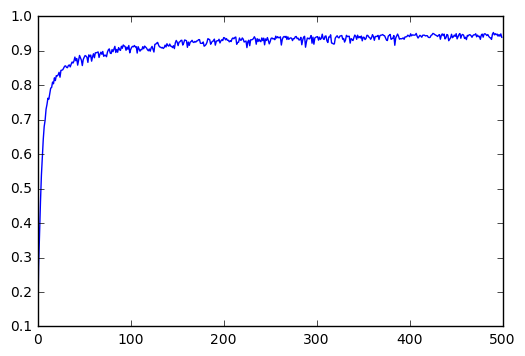

In [51]:
plt.plot(results.history['acc'])
plt.show()

In [53]:
predict(model_07_80_80_80, test_data, FACs_labels)

0.9139784946236559

## Bootstraping NN

In [ ]:
model_predictions = {}
models = {}
results = {}
for i in range(100):
    train_data, test_data = split_data_intwo(data=FACs_data, testing_size=2464)
    train_cells = train_data.index.tolist()
    test_cells = test_data.index.tolist()
    train_labels = FACs_labels.loc[train_cells, 'factor_cl']
    test_labels = FACs_labels.loc[test_cells, 'factor_cl']
    model = build_model(allow_dropouts=True, dropout_rate=0.7, HL_size=80, n_cluster= 93, n_features= 4020)
    result = run_keras2(model=model, batch_size=500,epochs=100, train_data=train_data, train_labels= train_labels)
    model_predictions[i] = model.predict(Patchseq_data)
    models[i] = model
    results[i] = result

Epoch 1/100
11000/11000 [==============================] - 3s 263us/step - loss: 4.5468 - acc: 0.1055

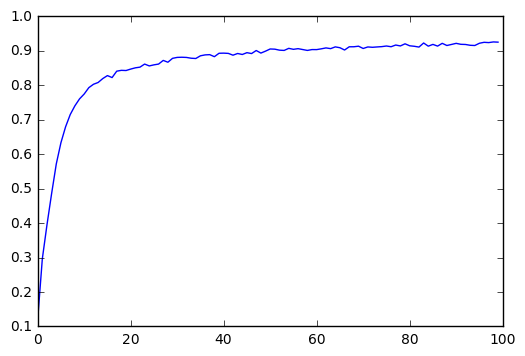

In [76]:
plt.plot(results[0].history['acc'])
plt.show()

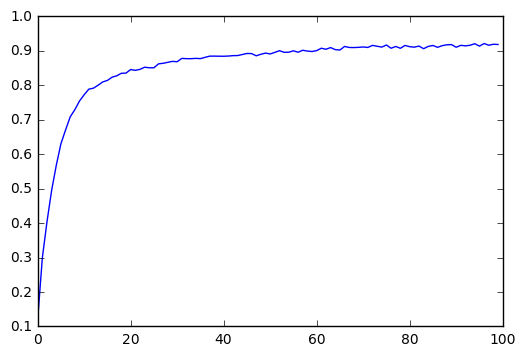

In [77]:
plt.plot(results[1].history['acc'])
plt.show()

In [83]:
models[1]